# Cloud bounding box classification - demonstation

## Prepare dataset

In [185]:
import json
from collections import defaultdict
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import patches, patheffects
import numpy as np
import seaborn as sns
import pandas as pd

In [174]:
!ls

fastai		    pascal-Copy1.ipynb	      retina_trn.csv
labelbox_0814.json  pascal-multi-Copy1.ipynb  retina_val.csv
NWPU-BB.ipynb	    retina_cls.csv	      view-cloud-labels.ipynb


In [175]:
IMG_PATH = '/project/meteo/w2w/A6/S.Rasp/MPI_Aqua/'

In [176]:
with open('labelbox_0814.json', 'r') as f:
    data = json.load(f)

In [205]:
# Delete last because it was a test
data = data[:-1]

In [206]:
len(data), data[0].keys()

(109,
 dict_keys(['ID', 'Labeled Data', 'Label', 'Created By', 'Project Name', 'Created At', 'Seconds to Label', 'External ID', 'Agreement', 'Dataset Name', 'Reviews']))

In [207]:
data[-2:]

[{'ID': 'cjkrerizq2irr0784bnsdtqny',
  'Labeled Data': 'https://firebasestorage.googleapis.com/v0/b/labelbox-193903.appspot.com/o/cjk176g29ncc70734knl44kor%2F45143287-d975-4b2b-bdfb-e61ecdea817e%2FAqua_CorrectedReflectance20110127.png?alt=media&token=c241e58c-59da-4611-bd3c-cd0b0832015f',
  'Label': {'Cold pool Box': [{'geometry': [{'x': 226, 'y': 702},
      {'x': 226, 'y': 255},
      {'x': 906, 'y': 255},
      {'x': 906, 'y': 702}]}]},
  'Created By': 'bjorn.stevens@mpimet.mpg.de',
  'Project Name': 'Cloud Classification Test',
  'Created At': '2018-08-12T22:15:50.000Z',
  'Seconds to Label': 7.502,
  'External ID': 'Aqua_CorrectedReflectance20110127.png',
  'Agreement': None,
  'Dataset Name': 'MPI-Clouds-Excerpt',
  'Reviews': []},
 {'ID': 'cjkrers1z2p5p0704ujysq3kv',
  'Labeled Data': 'https://firebasestorage.googleapis.com/v0/b/labelbox-193903.appspot.com/o/cjk176g29ncc70734knl44kor%2F45143287-d975-4b2b-bdfb-e61ecdea817e%2FAqua_CorrectedReflectance20100217.png?alt=media&token=e

In [208]:
fns = [d['External ID'] for d in data]

Get bottom left (id1) and top right (id3)

In [209]:
labeler = {d['External ID']: d['Created By'] for d in data}

In [210]:
labels = {d['External ID']: d['Label'] for d in data}

In [211]:
labels = defaultdict(list)
for d in data:
    cats = d['Label']
    if cats == 'Skip':
        labels[d['External ID']] = []
    else:
        for c in list(cats.keys()):
            bl_x = d['Label'][c][0]['geometry'][1]['x']
            bl_y = d['Label'][c][0]['geometry'][1]['y']
            tr_x = d['Label'][c][0]['geometry'][3]['x']
            tr_y = d['Label'][c][0]['geometry'][3]['y']
            labels[d['External ID']].append([c, (bl_x, bl_y, tr_x, tr_y)])

In [212]:
classes = [list(d['Label'].keys()) for d in data if d['Label'] != 'Skip']

In [213]:
classes = [item for sublist in classes for item in sublist]

In [214]:
classes = pd.Series(classes)

In [215]:
classes.unique()

array(['Shallow Box', 'Cold pool Box', 'Fishbone Box', 'Flower Box'],
      dtype=object)

In [216]:
classes.value_counts()

Cold pool Box    24
Shallow Box      17
Flower Box        9
Fishbone Box      7
dtype: int64

In [217]:
def bb_hw(a): return np.array([a[0],a[1],a[2]-a[0],a[3]-a[1]])

In [218]:
def show_img(fn, ax=None):
    if ax is None: fig, ax = plt.subplots(figsize=(10,10))
    img = Image.open(IMG_PATH + fn)
    ax.imshow(np.flipud(img), origin='lower')
    for l in labels[fn]:
        bb = bb_hw(l[1])
        patch = ax.add_patch(
            patches.Rectangle(bb[:2], *bb[-2:], fill=False, edgecolor='white', lw=2))
        ext = ax.text(*bb[:2], l[0],
                verticalalignment='bottom', color='white', fontsize=15, weight='bold')

In [219]:
cats = list(set(classes)); cats

['Shallow Box', 'Fishbone Box', 'Flower Box', 'Cold pool Box']

In [220]:
cat_fns = {c: [fn for fn, ls in labels.items() if c in [l[0] for l in ls]] for c in cats}

## Example labels

**Cloud categories**
- "1 - flower": Large-scale flower like patterns, with dark cloud free regions separating flowers
- "2 - fishbone": Like flowers but structures dominated by cold-pool networks, perhaps elongated.
- "3 - cold pool": regular network of small scale cold pools, and sometimes granular shallow clouds
- "4 - shallow": maybe stratiform clouds or regular bands, but evidently thin shallow clouds

**Instructions**
1. Try to identify an area with at least 1/8th 
 0. try to identify somewhere in the image an area (at least 1/8th the size of the image)  that best illustrates one of the classifications
1. draw the appropriate box around this feature
2. in some cases two features may be well represented, in these, rarer cases, draw two boxes
3. if no part substantial part of the images fits into the classification, skip it.

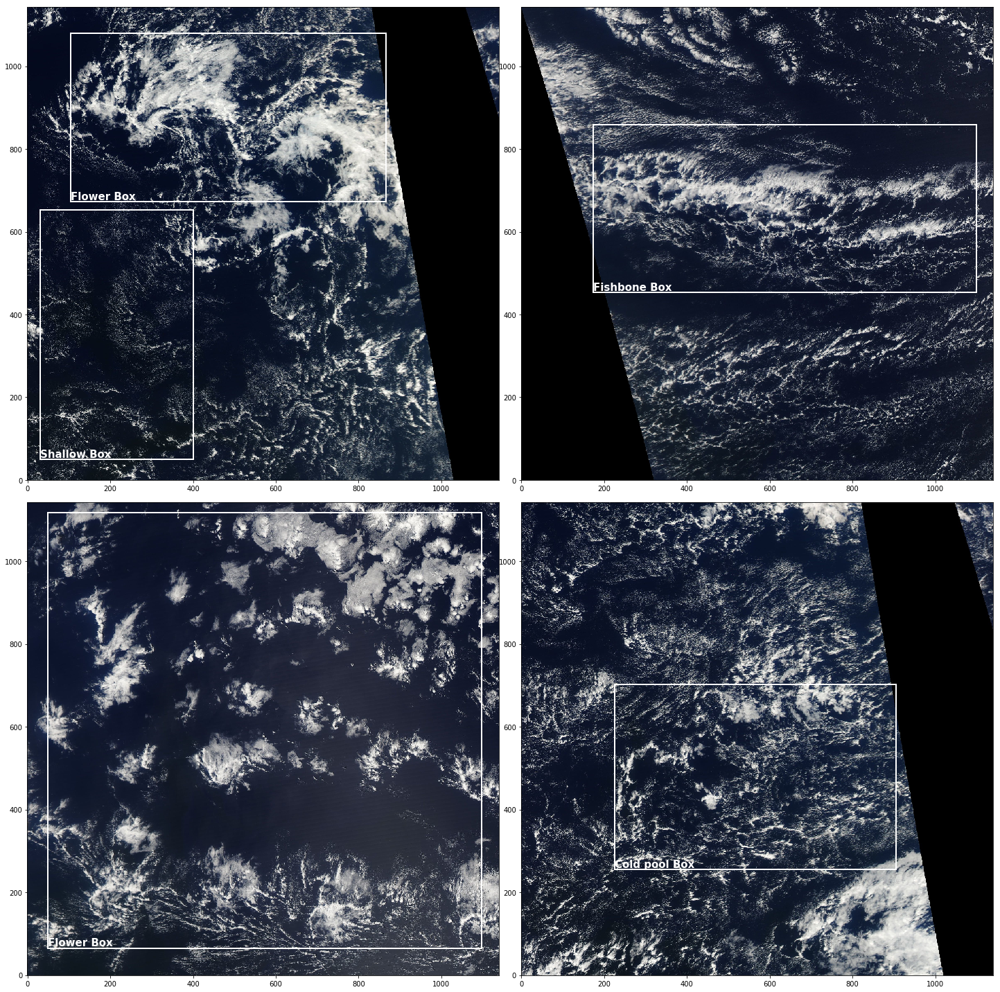

In [221]:
# Show one of each
fig, axs = plt.subplots(2, 2, figsize=(20,20))
for ax, c in zip(axs.flat, cats):
    show_img(cat_fns[c][-1], ax)
plt.tight_layout()

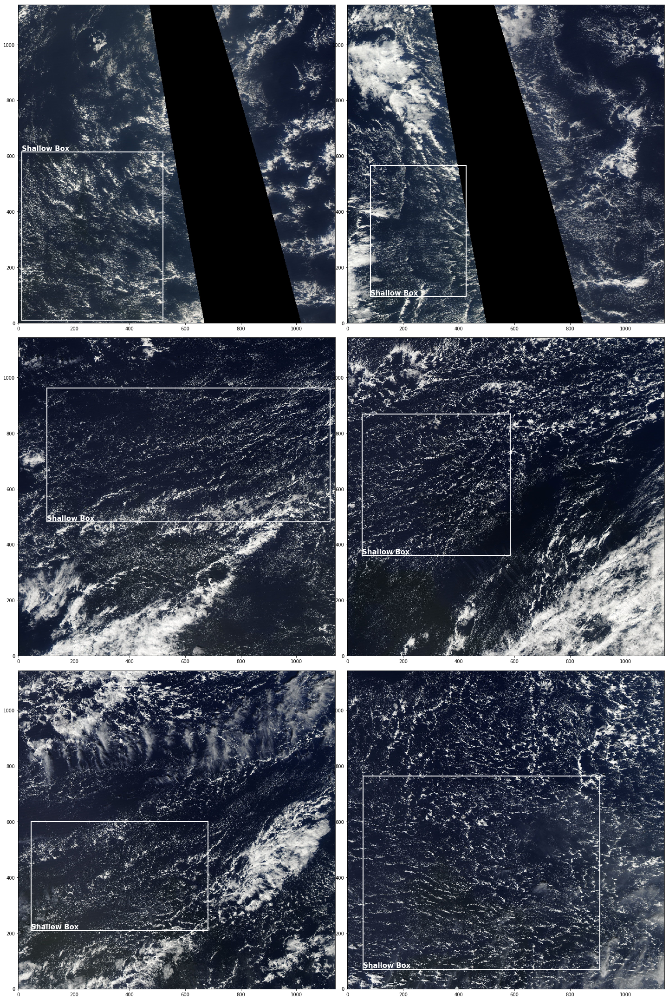

In [223]:
# Show 6 of each category
c = cats[0]
fig, axs = plt.subplots(3, 2, figsize=(20,30))
for ax, fn in zip(axs.flat, cat_fns[c][:6]):
    show_img(fn, ax)
plt.tight_layout()

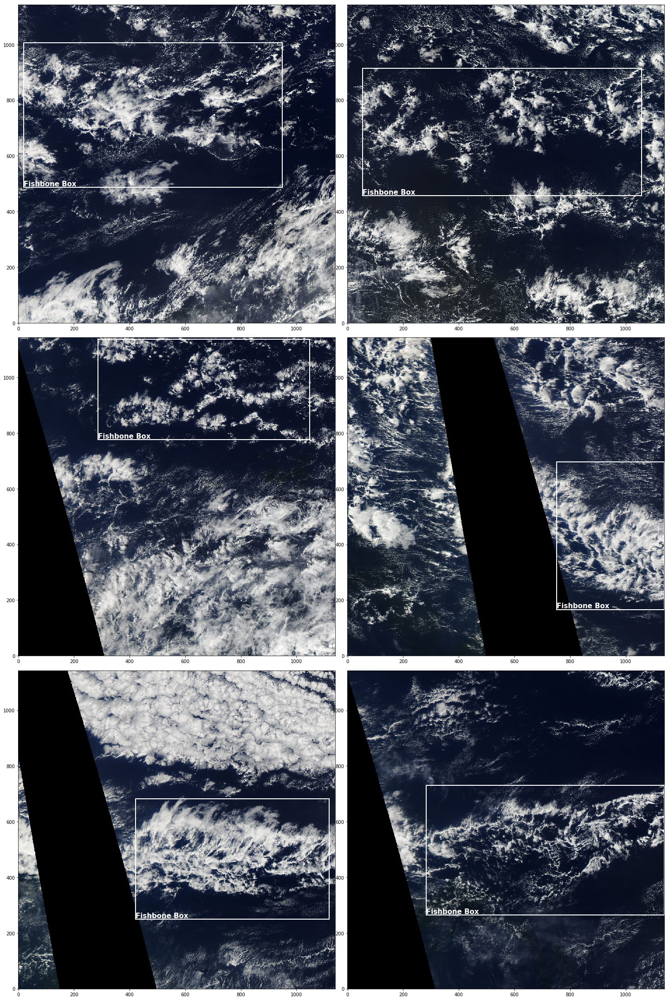

In [224]:
# Show 6 of each category
c = cats[1]
fig, axs = plt.subplots(3, 2, figsize=(20,30))
for ax, fn in zip(axs.flat, cat_fns[c][:6]):
    show_img(fn, ax)
plt.tight_layout()

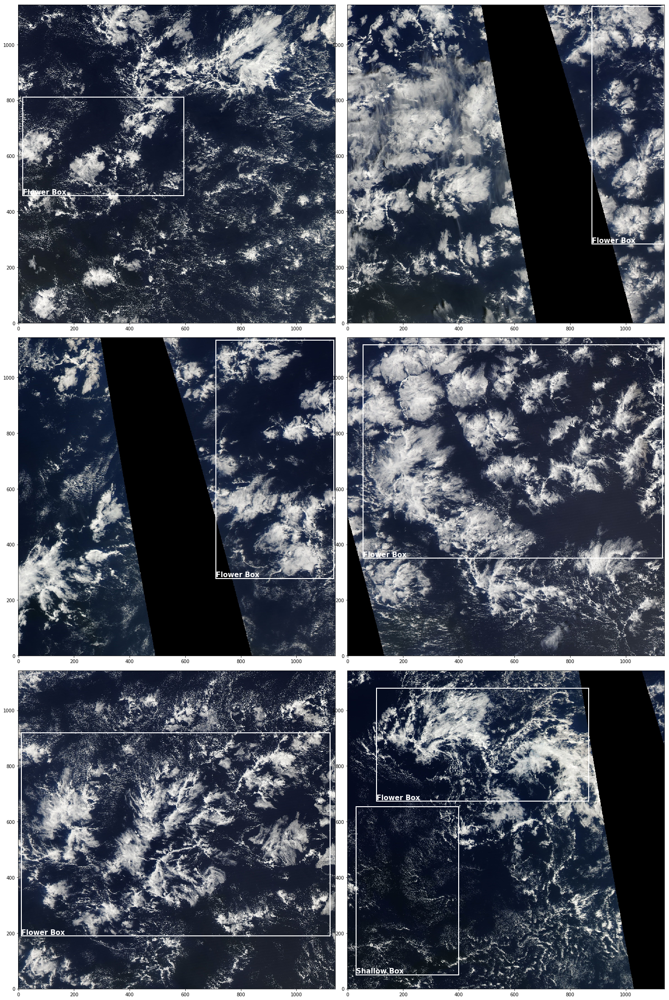

In [225]:
# Show 6 of each category
c = cats[2]
fig, axs = plt.subplots(3, 2, figsize=(20,30))
for ax, fn in zip(axs.flat, cat_fns[c][:6]):
    show_img(fn, ax)
plt.tight_layout()

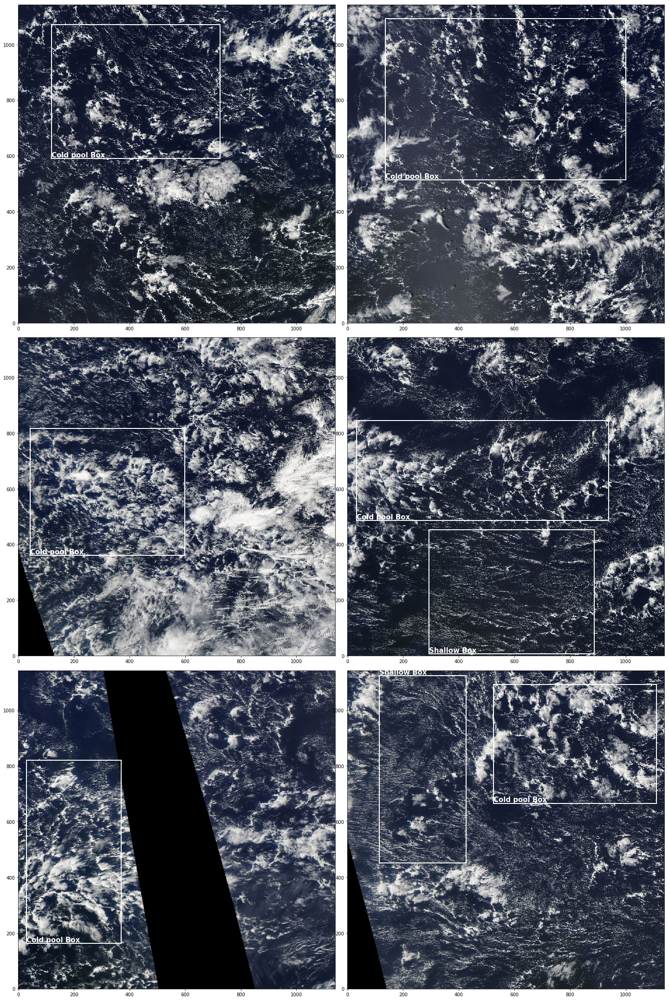

In [226]:
# Show 6 of each category
c = cats[3]
fig, axs = plt.subplots(3, 2, figsize=(20,30))
for ax, fn in zip(axs.flat, cat_fns[c][:6]):
    show_img(fn, ax)
plt.tight_layout()